In [1]:
try:
    import torchgan

    print(f"Existing TorchGAN {torchgan.__version__} installation found")
except ImportError:
    import subprocess
    import sys

    subprocess.check_call([sys.executable, "-m", "pip", "install", "torchgan"])
    import torchgan

    print(f"Installed TorchGAN {torchgan.__version__}")

Existing TorchGAN v0.1.0 installation found


In [2]:
# General Imports
import os
import random
import matplotlib.pyplot as plt
import matplotlib.animation as animation
import numpy as np
from IPython.display import HTML

# Pytorch and Torchvision Imports
import torch
import torch.nn as nn
import torch.nn.functional as F
import torchvision
import torchvision.transforms as T
from torch.optim import Adam
import torch.utils.data as data
import torchvision.datasets as dsets
import torchvision.transforms as transforms
import torchvision.utils as vutils

# Torchgan Imports
import torchgan.models as models
import torchgan.losses as losses
from torchgan.trainer import Trainer

In [3]:
# Set random seed for reproducibility
manualSeed = 999
random.seed(manualSeed)
torch.manual_seed(manualSeed)
print("Random Seed: ", manualSeed)


Random Seed:  999


In [4]:
dataset = dsets.MNIST(
    root="./data/mnist",
    train=True,
    transform=transforms.Compose(
        [
            transforms.Resize((32, 32)),
            transforms.ToTensor(),
            transforms.Normalize(mean=(0.5,), std=(0.5,)),
        ]
    ),
    download=True,
)

In [5]:
loader = data.DataLoader(dataset, batch_size=64, shuffle=True)

In [6]:
class AdversarialAutoencoderGenerator(models.Generator):
    def __init__(
        self,
        encoding_dims,
        input_size,
        input_channels,
        step_channels=16,
        nonlinearity=nn.LeakyReLU(0.2),
    ):
        super(AdversarialAutoencoderGenerator, self).__init__(encoding_dims)
        encoder = [
            nn.Sequential(
                nn.Conv2d(input_channels, step_channels, 5, 2, 2), nonlinearity
            )
        ]
        size = input_size // 2
        channels = step_channels
        while size > 1:
            encoder.append(
                nn.Sequential(
                    nn.Conv2d(channels, channels * 4, 5, 4, 2),
                    nn.BatchNorm2d(channels * 4),
                    nonlinearity,
                )
            )
            channels *= 4
            size = size // 4
        self.encoder = nn.Sequential(*encoder)
        self.encoder_fc = nn.Linear(
            channels, encoding_dims
        )  # Can add a Tanh nonlinearity if training is unstable as noise prior is Gaussian
        self.decoder_fc = nn.Linear(encoding_dims, step_channels)
        decoder = []
        size = 1
        channels = step_channels
        while size < input_size // 2:
            decoder.append(
                nn.Sequential(
                    nn.ConvTranspose2d(channels, channels * 4, 5, 4, 2, 3),
                    nn.BatchNorm2d(channels * 4),
                    nonlinearity,
                )
            )
            channels *= 4
            size *= 4
        decoder.append(nn.ConvTranspose2d(channels, input_channels, 5, 2, 2, 1))
        self.decoder = nn.Sequential(*decoder)

    def sample(self, noise):
        noise = self.decoder_fc(noise)
        noise = noise.view(-1, noise.size(1), 1, 1)
        return self.decoder(noise)

    def forward(self, x):
        if self.training:
            encoding = self.encoder(x)
            encoding = self.encoder_fc(
                encoding.view(
                    -1, encoding.size(1) * encoding.size(2) * encoding.size(3)
                )
            )
            return self.sample(encoding), encoding
        else:
            return self.sample(x)

In [7]:
class AdversarialAutoencoderDiscriminator(models.Discriminator):
    def __init__(self, input_dims, nonlinearity=nn.LeakyReLU(0.2)):
        super(AdversarialAutoencoderDiscriminator, self).__init__(input_dims)
        model = [nn.Sequential(nn.Linear(input_dims, input_dims // 2), nonlinearity)]
        size = input_dims // 2
        while size > 16:
            model.append(
                nn.Sequential(
                    nn.Linear(size, size // 2), nn.BatchNorm1d(size // 2), nonlinearity
                )
            )
            size = size // 2
        model.append(nn.Linear(size, 1))
        self.model = nn.Sequential(*model)

    def forward(self, x):
        return self.model(x)

In [8]:
class AdversarialAutoencoderGeneratorLoss(losses.GeneratorLoss):
    def forward(self, real_inputs, gen_inputs, dgz):
        loss = 0.999 * F.mse_loss(gen_inputs, real_inputs)
        target = torch.ones_like(dgz)
        loss += 0.001 * F.binary_cross_entropy_with_logits(dgz, target)
        return loss

    def train_ops(
        self,
        generator,
        discriminator,
        optimizer_generator,
        real_inputs,
        device,
        batch_size,
        labels=None,
    ):
        recon, encodings = generator(real_inputs)
        optimizer_generator.zero_grad()
        dgz = discriminator(encodings)
        loss = self.forward(real_inputs, recon, dgz)
        loss.backward()
        optimizer_generator.step()
        return loss.item()


class AdversarialAutoencoderDiscriminatorLoss(losses.DiscriminatorLoss):
    def forward(self, dx, dgz):
        target_real = torch.ones_like(dx)
        target_fake = torch.zeros_like(dx)
        loss = 0.5 * F.binary_cross_entropy_with_logits(dx, target_real)
        loss += 0.5 * F.binary_cross_entropy_with_logits(dgz, target_fake)
        return loss

    def train_ops(
        self,
        generator,
        discriminator,
        optimizer_discriminator,
        real_inputs,
        device,
        batch_size,
        labels=None,
    ):
        _, encodings = generator(real_inputs)
        noise = torch.randn(real_inputs.size(0), generator.encoding_dims, device=device)
        optimizer_discriminator.zero_grad()
        dx = discriminator(noise)
        dgz = discriminator(encodings)
        loss = self.forward(dx, dgz)
        loss.backward()
        optimizer_discriminator.step()
        return loss.item()


losses = [
    AdversarialAutoencoderGeneratorLoss(),
    AdversarialAutoencoderDiscriminatorLoss(),
]

In [9]:
network = {
    "generator": {
        "name": AdversarialAutoencoderGenerator,
        "args": {"encoding_dims": 128, "input_size": 32, "input_channels": 1},
        "optimizer": {"name": Adam, "args": {"lr": 0.0002, "betas": (0.5, 0.999)}},
    },
    "discriminator": {
        "name": AdversarialAutoencoderDiscriminator,
        "args": {"input_dims": 128,},
        "optimizer": {"name": Adam, "args": {"lr": 0.0002, "betas": (0.5, 0.999)}},
    },
}

In [14]:
if torch.cuda.is_available():
    device = torch.device("cuda:0")
    # Use deterministic cudnn algorithms
    torch.backends.cudnn.deterministic = True
    epochs = 200
else:
    device = torch.device("cpu")
    epochs = 200

print("Device: {}".format(device))
print("Epochs: {}".format(epochs))

Device: cuda:0
Epochs: 200


In [15]:
trainer = Trainer(network, losses, sample_size=64, epochs=epochs, device=device, checkpoints='models/gan')
trainer(loader)

Saving Model at 'models/gan0.model'
Epoch 1 Summary
Epoch time duration : 25.920331478118896
generator Mean Gradients : 75.8301039402914
discriminator Mean Gradients : 0.09871839108613768
Mean Running Discriminator Loss : 0.6498184893558274
Mean Running Generator Loss : 0.23668323592272902
Generating and Saving Images to ./images/epoch1_generator.png

Saving Model at 'models/gan1.model'
Epoch 2 Summary
Epoch time duration : 26.279414415359497
generator Mean Gradients : 42.3672931810016
discriminator Mean Gradients : 0.5428677355767276
Mean Running Discriminator Loss : 0.5707452581413011
Mean Running Generator Loss : 0.19036222925223012
Generating and Saving Images to ./images/epoch2_generator.png

Saving Model at 'models/gan2.model'
Epoch 3 Summary
Epoch time duration : 25.579421281814575
generator Mean Gradients : 29.696268771939817
discriminator Mean Gradients : 0.8379545400569853
Mean Running Discriminator Loss : 0.4796716440799987
Mean Running Generator Loss : 0.17142774427856378
G

Saving Model at 'models/gan4.model'
Epoch 25 Summary
Epoch time duration : 29.080163955688477
generator Mean Gradients : 3.8868100747815033
discriminator Mean Gradients : 30.70157107376836
Mean Running Discriminator Loss : 0.33067854796105356
Mean Running Generator Loss : 0.11841090750910326
Generating and Saving Images to ./images/epoch25_generator.png

Saving Model at 'models/gan0.model'
Epoch 26 Summary
Epoch time duration : 29.685558795928955
generator Mean Gradients : 3.7388653036630637
discriminator Mean Gradients : 31.65695886584709
Mean Running Discriminator Loss : 0.331726282642235
Mean Running Generator Loss : 0.11790132509324225
Generating and Saving Images to ./images/epoch26_generator.png

Saving Model at 'models/gan1.model'
Epoch 27 Summary
Epoch time duration : 28.207499027252197
generator Mean Gradients : 3.6018556494917897
discriminator Mean Gradients : 32.81810583412058
Mean Running Discriminator Loss : 0.33398900812351007
Mean Running Generator Loss : 0.1174239822389

Saving Model at 'models/gan3.model'
Epoch 49 Summary
Epoch time duration : 29.258846282958984
generator Mean Gradients : 1.9981089711961424
discriminator Mean Gradients : 57.17217065553274
Mean Running Discriminator Loss : 0.3833429677576692
Mean Running Generator Loss : 0.11122883197785301
Generating and Saving Images to ./images/epoch49_generator.png

Saving Model at 'models/gan4.model'
Epoch 50 Summary
Epoch time duration : 28.574202299118042
generator Mean Gradients : 1.9586206877385834
discriminator Mean Gradients : 58.043252584798324
Mean Running Discriminator Loss : 0.3850586086243137
Mean Running Generator Loss : 0.11105633051267692
Generating and Saving Images to ./images/epoch50_generator.png

Saving Model at 'models/gan0.model'
Epoch 51 Summary
Epoch time duration : 29.311238527297974
generator Mean Gradients : 1.9206767916215146
discriminator Mean Gradients : 59.034316592596376
Mean Running Discriminator Loss : 0.38698218958444947
Mean Running Generator Loss : 0.11088962095

Saving Model at 'models/gan2.model'
Epoch 73 Summary
Epoch time duration : 28.16069746017456
generator Mean Gradients : 1.3481995920320928
discriminator Mean Gradients : 75.14698653460562
Mean Running Discriminator Loss : 0.41347338605526207
Mean Running Generator Loss : 0.1082616469384025
Generating and Saving Images to ./images/epoch73_generator.png

Saving Model at 'models/gan3.model'
Epoch 74 Summary
Epoch time duration : 28.27892518043518
generator Mean Gradients : 1.3302319966379628
discriminator Mean Gradients : 75.73451367967562
Mean Running Discriminator Loss : 0.4147791194049035
Mean Running Generator Loss : 0.1081729291096765
Generating and Saving Images to ./images/epoch74_generator.png

Saving Model at 'models/gan4.model'
Epoch 75 Summary
Epoch time duration : 28.555790424346924
generator Mean Gradients : 1.312737726661611
discriminator Mean Gradients : 76.29366481193851
Mean Running Discriminator Loss : 0.4159379475081357
Mean Running Generator Loss : 0.10808464593142166


Saving Model at 'models/gan1.model'
Epoch 97 Summary
Epoch time duration : 28.48425817489624
generator Mean Gradients : 1.0187212044920344
discriminator Mean Gradients : 86.88627176696167
Mean Running Discriminator Loss : 0.43452803352809005
Mean Running Generator Loss : 0.10652397955464357
Generating and Saving Images to ./images/epoch97_generator.png

Saving Model at 'models/gan2.model'
Epoch 98 Summary
Epoch time duration : 28.133127212524414
generator Mean Gradients : 1.0084761079954592
discriminator Mean Gradients : 87.22934623068362
Mean Running Discriminator Loss : 0.4352388238176651
Mean Running Generator Loss : 0.10646663287326341
Generating and Saving Images to ./images/epoch98_generator.png

Saving Model at 'models/gan3.model'
Epoch 99 Summary
Epoch time duration : 28.96597933769226
generator Mean Gradients : 0.9984376868085029
discriminator Mean Gradients : 87.58796028230223
Mean Running Discriminator Loss : 0.4357109256854155
Mean Running Generator Loss : 0.106409549723083

Saving Model at 'models/gan4.model'
Epoch 120 Summary
Epoch time duration : 28.379088640213013
generator Mean Gradients : 0.8261729624091706
discriminator Mean Gradients : 95.5612111639986
Mean Running Discriminator Loss : 0.4467099671066734
Mean Running Generator Loss : 0.10542325987642752
Generating and Saving Images to ./images/epoch120_generator.png

Saving Model at 'models/gan0.model'
Epoch 121 Summary
Epoch time duration : 28.007941961288452
generator Mean Gradients : 0.819449348150388
discriminator Mean Gradients : 95.90982475053508
Mean Running Discriminator Loss : 0.4473432186836645
Mean Running Generator Loss : 0.10538111423661359
Generating and Saving Images to ./images/epoch121_generator.png

Saving Model at 'models/gan1.model'
Epoch 122 Summary
Epoch time duration : 28.32045030593872
generator Mean Gradients : 0.8128371637802505
discriminator Mean Gradients : 96.2980944476508
Mean Running Discriminator Loss : 0.4480086930121281
Mean Running Generator Loss : 0.1053400781643

Saving Model at 'models/gan2.model'
Epoch 143 Summary
Epoch time duration : 28.117488861083984
generator Mean Gradients : 0.6951894716273388
discriminator Mean Gradients : 102.29612355433457
Mean Running Discriminator Loss : 0.45948240274294394
Mean Running Generator Loss : 0.10457175920247376
Generating and Saving Images to ./images/epoch143_generator.png

Saving Model at 'models/gan3.model'
Epoch 144 Summary
Epoch time duration : 28.275036096572876
generator Mean Gradients : 0.6904394407602814
discriminator Mean Gradients : 102.48552500620399
Mean Running Discriminator Loss : 0.45988352337049654
Mean Running Generator Loss : 0.10453947887958258
Generating and Saving Images to ./images/epoch144_generator.png

Saving Model at 'models/gan4.model'
Epoch 145 Summary
Epoch time duration : 27.97220540046692
generator Mean Gradients : 0.6857523904506134
discriminator Mean Gradients : 102.67950529016001
Mean Running Discriminator Loss : 0.4604261486184732
Mean Running Generator Loss : 0.10450

Saving Model at 'models/gan0.model'
Epoch 166 Summary
Epoch time duration : 28.199211835861206
generator Mean Gradients : 0.6003320599785471
discriminator Mean Gradients : 105.8389765744217
Mean Running Discriminator Loss : 0.46799222636574284
Mean Running Generator Loss : 0.10390785834585865
Generating and Saving Images to ./images/epoch166_generator.png

Saving Model at 'models/gan1.model'
Epoch 167 Summary
Epoch time duration : 28.78188419342041
generator Mean Gradients : 0.5967994207921741
discriminator Mean Gradients : 105.97213250479724
Mean Running Discriminator Loss : 0.4683182212514211
Mean Running Generator Loss : 0.10388255592035069
Generating and Saving Images to ./images/epoch167_generator.png

Saving Model at 'models/gan2.model'
Epoch 168 Summary
Epoch time duration : 28.14845037460327
generator Mean Gradients : 0.5933056766993343
discriminator Mean Gradients : 106.07643603274441
Mean Running Discriminator Loss : 0.4686554781642938
Mean Running Generator Loss : 0.10385669

Saving Model at 'models/gan3.model'
Epoch 189 Summary
Epoch time duration : 27.041101217269897
generator Mean Gradients : 0.5284234546095118
discriminator Mean Gradients : 107.68177546124103
Mean Running Discriminator Loss : 0.47741884240345756
Mean Running Generator Loss : 0.10335331118823582
Generating and Saving Images to ./images/epoch189_generator.png

Saving Model at 'models/gan4.model'
Epoch 190 Summary
Epoch time duration : 27.412833213806152
generator Mean Gradients : 0.5256899271946299
discriminator Mean Gradients : 107.72635542113973
Mean Running Discriminator Loss : 0.4776967262396249
Mean Running Generator Loss : 0.1033316818143386
Generating and Saving Images to ./images/epoch190_generator.png

Saving Model at 'models/gan0.model'
Epoch 191 Summary
Epoch time duration : 27.39652919769287
generator Mean Gradients : 0.5229849510050506
discriminator Mean Gradients : 107.76381381310667
Mean Running Discriminator Loss : 0.4780315095638713
Mean Running Generator Loss : 0.1033098

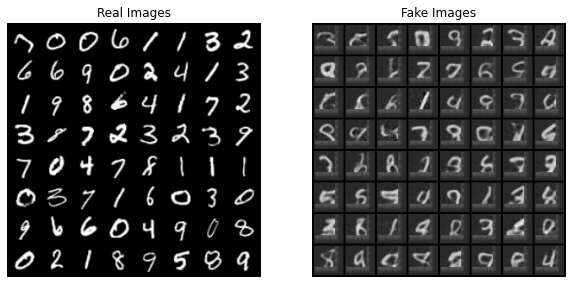

In [16]:
# Grab a batch of real images from the dataloader
real_batch = next(iter(loader))

# Plot the real images
plt.figure(figsize=(10, 10))
plt.subplot(1, 2, 1)
plt.axis("off")
plt.title("Real Images")
plt.imshow(
    np.transpose(
        vutils.make_grid(
            real_batch[0].to(device)[:64], padding=5, normalize=True
        ).cpu(),
        (1, 2, 0),
    )
)

# Plot the fake images from the last epoch
plt.subplot(1, 2, 2)
plt.axis("off")
plt.title("Fake Images")
plt.imshow(plt.imread("{}/epoch{}_generator.png".format(trainer.recon, trainer.epochs)))
plt.show()

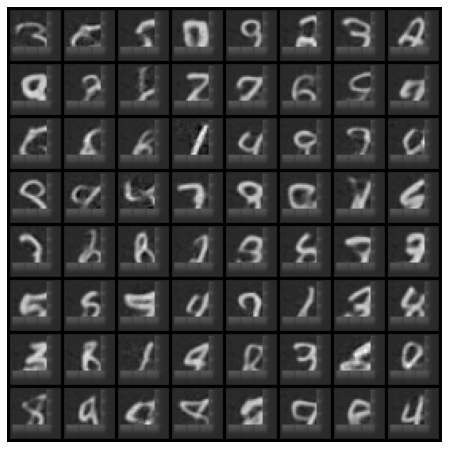

In [17]:
fig = plt.figure(figsize=(8, 8))
plt.axis("off")
ims = [
    [plt.imshow(plt.imread("{}/epoch{}_generator.png".format(trainer.recon, i)))]
    for i in range(1, trainer.epochs + 1)
]
ani = animation.ArtistAnimation(fig, ims, interval=1000, repeat_delay=1000, blit=True)

# Play the animation
HTML(ani.to_jshtml())